# Visión por computador I

## Trabajo Práctico 1

Integrantes: 
- Andújar Martin a2102
- Ceballos Luciano a2110
- Otonelo Nahuel a2125

In [ ]:

import numpy as np #
import cv2 as cv

import matplotlib.pyplot as plt
import os



**En esta primera parte** se implementa el algoritmo White Patch para mejorar las diferencias de color de iluminación en imagenes dadas.

Primero se normaliza cada canal de color basándose en su valor máximo, asumiendo que el punto más brillante en la imagen es un reflector perfecto (blanco). Este método de tomar el máximo no funciona muy bien en algunos casos, entonces luego en vez de tomar este máximo se toma un percentil, resignando saturacion en algunos puntos, pero dando mas contraste en el resto. Se prueban distintos valores de percentiles y se comparan resultados

In [5]:


def cargar_y_mostrar_imagen(ruta_imagen):
    """
    Carga una imagen desde una ruta de archivo y la devuelve en formato RGB.

    Args:
        ruta_imagen (str): La ruta completa del archivo de imagen.

    Returns:
        numpy.ndarray: La imagen en formato RGB (Rojo, Verde, Azul) de 8 bits (0-255), 
                       o None si la carga falla.
    """
    # 1. Cargar la imagen usando OpenCV
    # Por defecto, cv.imread() carga en formato BGR (Azul, Verde, Rojo)
    img_bgr = cv.imread(ruta_imagen)

    if img_bgr is None:
        print(f"ERROR: No se pudo cargar la imagen. Revise la ruta: '{ruta_imagen}'")
        return None

    # 2. Convertir la imagen de BGR a RGB
    img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)

    return img_rgb



Imagen cargada correctamente con dimensiones: (100, 278, 3)


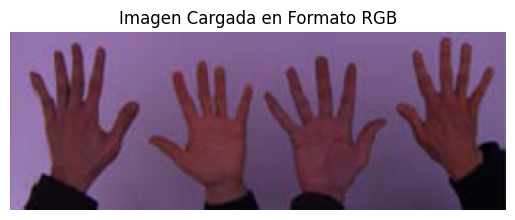

In [6]:

test_blue = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\white_patch\test_blue.png"

# Llama a la función de carga
manos_blue = cargar_y_mostrar_imagen(test_blue)

if manos_blue is not None:
    print(f"Imagen cargada correctamente con dimensiones: {manos_blue.shape}")
    # Ahora puedes pasar 'imagen_bgr_original' a la función white_patch_correction
    # Visualizar la imagen para verificar (usando Matplotlib que espera RGB)
    plt.imshow(manos_blue)
    plt.title("Imagen Cargada en Formato RGB")
    plt.axis('off')
    plt.show()

Imagen cargada correctamente con dimensiones: (100, 278, 3)


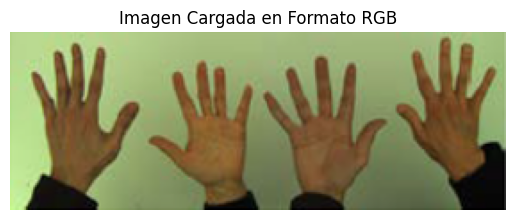

In [7]:


test_green = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\white_patch\test_green.png"

# Llama a la función de carga
manos_green = cargar_y_mostrar_imagen(test_green)

if manos_green is not None:
    print(f"Imagen cargada correctamente con dimensiones: {manos_green.shape}")
    # Ahora puedes pasar 'imagen_bgr_original' a la función white_patch_correction
    # Visualizar la imagen para verificar (usando Matplotlib que espera RGB)
    plt.imshow(manos_green)
    plt.title("Imagen Cargada en Formato RGB")
    plt.axis('off')
    plt.show()

Imagen cargada correctamente con dimensiones: (99, 276, 3)


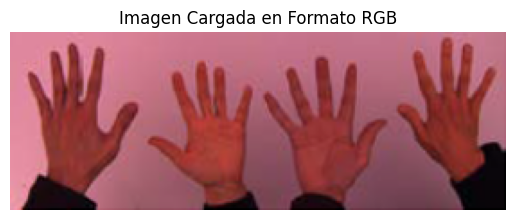

In [8]:
test_red = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\white_patch\test_red.png"

# Llama a la función de carga
manos_red = cargar_y_mostrar_imagen(test_red)

if manos_red is not None:
    print(f"Imagen cargada correctamente con dimensiones: {manos_red.shape}")
    # Ahora puedes pasar 'imagen_bgr_original' a la función white_patch_correction
    # Visualizar la imagen para verificar (usando Matplotlib que espera RGB)
    plt.imshow(manos_red)
    plt.title("Imagen Cargada en Formato RGB")
    plt.axis('off')
    plt.show()

### Defininición de la función white patch

In [9]:


def white_patch_rgb(img_rgb):
    """
    Aplica el algoritmo White Patch (MaxRGB) a una imagen RGB para corregir
    la dominante de color (balance de blancos).

    Args:
        img_rgb (numpy.ndarray): La imagen de entrada en formato RGB (Rojo, Verde, Azul).
                                 Debe estar en el rango [0, 255] y tipo np.uint8.

    Returns:
        numpy.ndarray: La imagen corregida en formato RGB, también en el rango [0, 255]
                       y tipo np.uint8.
    """
    # 1. Preparación: Convertir a punto flotante (0.0 a 1.0)
    # Esto evita desbordamientos y facilita la multiplicación.
    img_float = img_rgb.astype(np.float32) / 255.0
    
    # Definir el máximo valor de referencia (1.0 para el rango float)
    C_max = 1.0

    # 2. Identificar el valor máximo para cada canal
    # R: canal 0, G: canal 1, B: canal 2
    R_max = np.max(img_float[:, :, 0])
    G_max = np.max(img_float[:, :, 1])
    B_max = np.max(img_float[:, :, 2])
    
    # Opcional: Mostrar los máximos para ver el sesgo de color
    print(f"Máximos detectados (R, G, B): ({R_max:.4f}, {G_max:.4f}, {B_max:.4f})")

    # 3. Calcular los factores de ganancia (K = C_max / C_max_actual)
    # Si un canal está muy bajo (ej. B_max = 0.5), su ganancia (K_B) será alta (2.0)
    K_R = C_max / R_max
    K_G = C_max / G_max
    K_B = C_max / B_max

    # 4. Aplicar los factores de ganancia a todos los píxeles
    img_corrected = np.zeros_like(img_float)
    
    # Aplicación al canal Rojo
    img_corrected[:, :, 0] = img_float[:, :, 0] * K_R
    # Aplicación al canal Verde
    img_corrected[:, :, 1] = img_float[:, :, 1] * K_G
    # Aplicación al canal Azul
    img_corrected[:, :, 2] = img_float[:, :, 2] * K_B

    # 5. Asegurar que los valores no excedan el rango [0.0, 1.0] (clipping)
    img_corrected = np.clip(img_corrected, 0.0, 1.0)

    # 6. Finalización: Convertir de nuevo a formato de 8 bits (0-255)
    img_output = (img_corrected * 255).astype(np.uint8)

    return img_output


In [12]:
def mostrar_comparacion(img_original_rgb, img_corregida_rgb, titulo_original="Imagen Original", titulo_corregida="White Patch Corregida"):
    """
    Muestra la imagen original y la corregida en una sola figura con dos subplots.

    Args:
        img_original_rgb (numpy.ndarray): La imagen de entrada original (RGB, 0-255).
        img_corregida_rgb (numpy.ndarray): La imagen corregida por White Patch (RGB, 0-255).
        titulo_original (str, optional): Título para el subplot de la imagen original.
        titulo_corregida (str, optional): Título para el subplot de la imagen corregida.
    """
    # Crear una figura con una fila y dos columnas (1x2) para los subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # --- Subplot 1: Imagen Original ---
    axes[0].imshow(img_original_rgb)
    axes[0].set_title(titulo_original)
    axes[0].axis('off') # Ocultar ejes

    # --- Subplot 2: Imagen Corregida ---
    axes[1].imshow(img_corregida_rgb)
    axes[1].set_title(titulo_corregida)
    axes[1].axis('off') # Ocultar ejes

    # Ajustar el diseño para que no se solapen y mostrar
    plt.tight_layout()
    plt.show()

Máximos detectados (R, G, B): (0.6471, 0.5412, 0.7843)


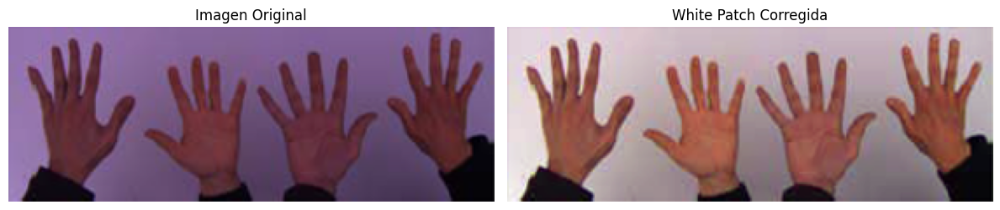

In [13]:
mostrar_comparacion(manos_blue, white_patch_rgb(manos_blue), titulo_original="Imagen Original", titulo_corregida="White Patch Corregida")

Máximos detectados (R, G, B): (0.8235, 0.9804, 0.6706)


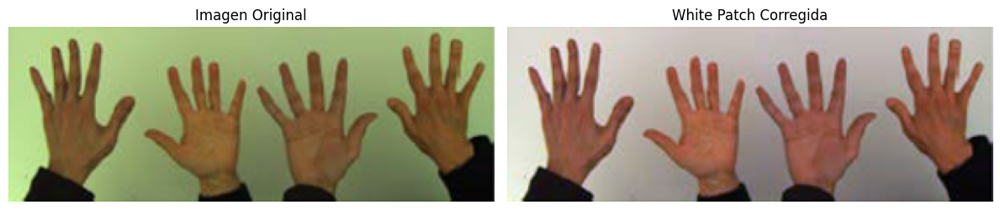

In [14]:
mostrar_comparacion(manos_green, white_patch_rgb(manos_green), titulo_original="Imagen Original", titulo_corregida="White Patch Corregida")

Máximos detectados (R, G, B): (0.9686, 0.6157, 0.6863)


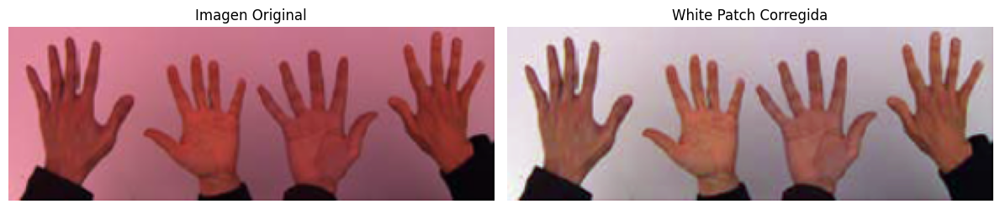

In [15]:
mostrar_comparacion(manos_red, white_patch_rgb(manos_red), titulo_original="Imagen Original", titulo_corregida="White Patch Corregida")

In [16]:
wp_blue = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\white_patch\wp_blue.jpg"

wp_blue = cargar_y_mostrar_imagen(wp_blue)

Iniciando procesamiento de 5 imágenes...

Procesando: wp_blue.jpg...
Máximos detectados (R, G, B): (1.0000, 1.0000, 1.0000)


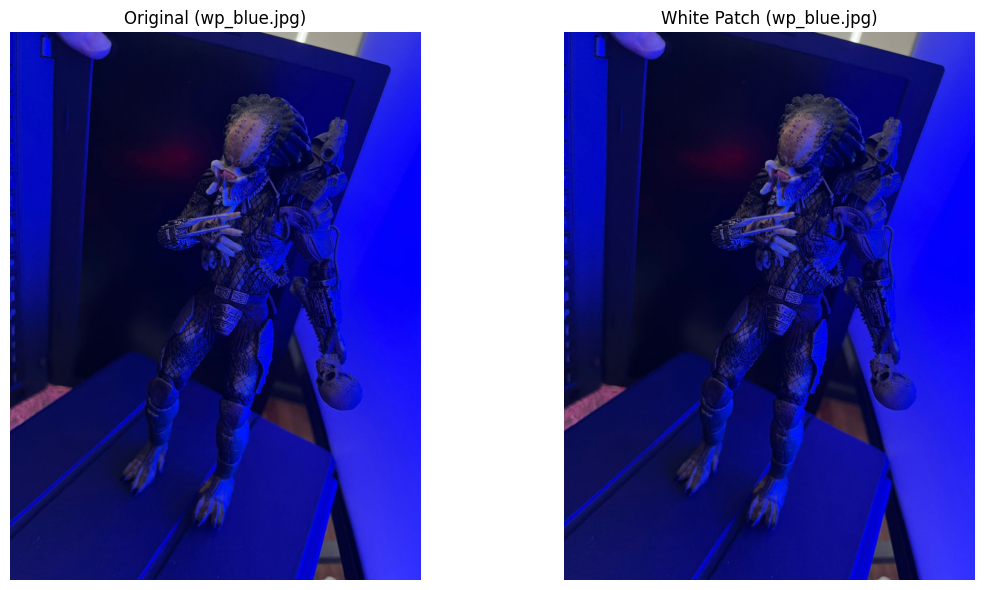


Procesando: wp_green.png...
Máximos detectados (R, G, B): (0.4941, 0.9882, 0.6078)


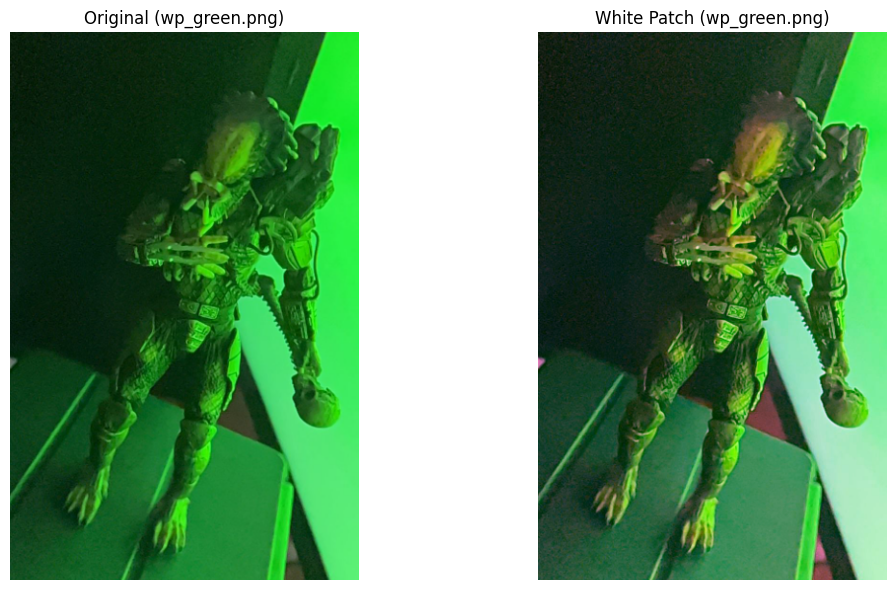


Procesando: wp_green2.jpg...
Máximos detectados (R, G, B): (0.6667, 1.0000, 0.6745)


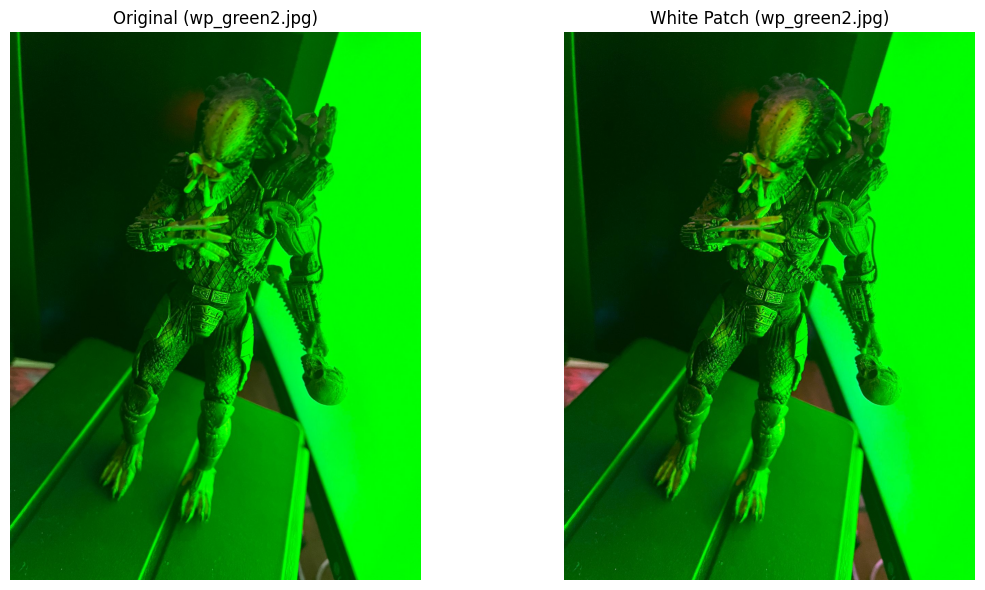


Procesando: wp_red.png...
Máximos detectados (R, G, B): (1.0000, 0.5255, 0.4784)


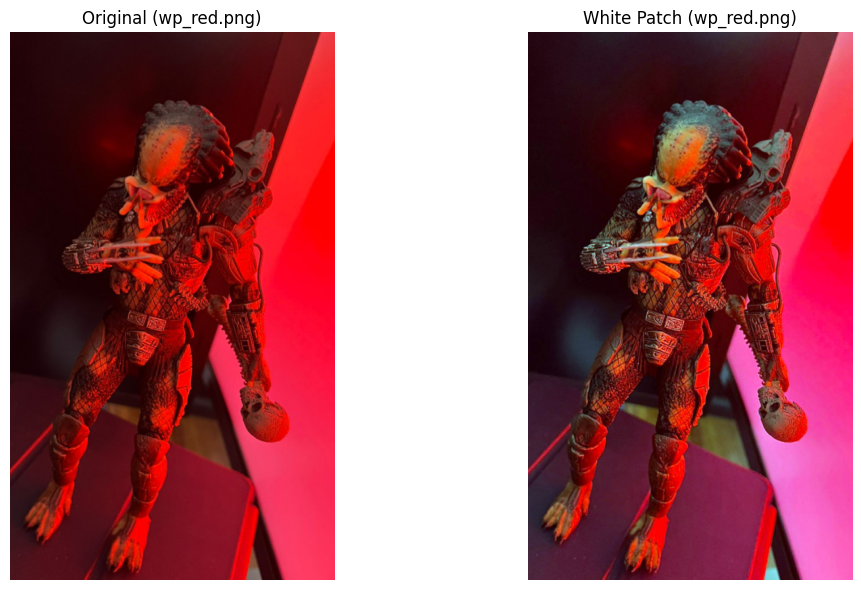


Procesando: wp_red2.jpg...
Máximos detectados (R, G, B): (1.0000, 0.7882, 0.7961)


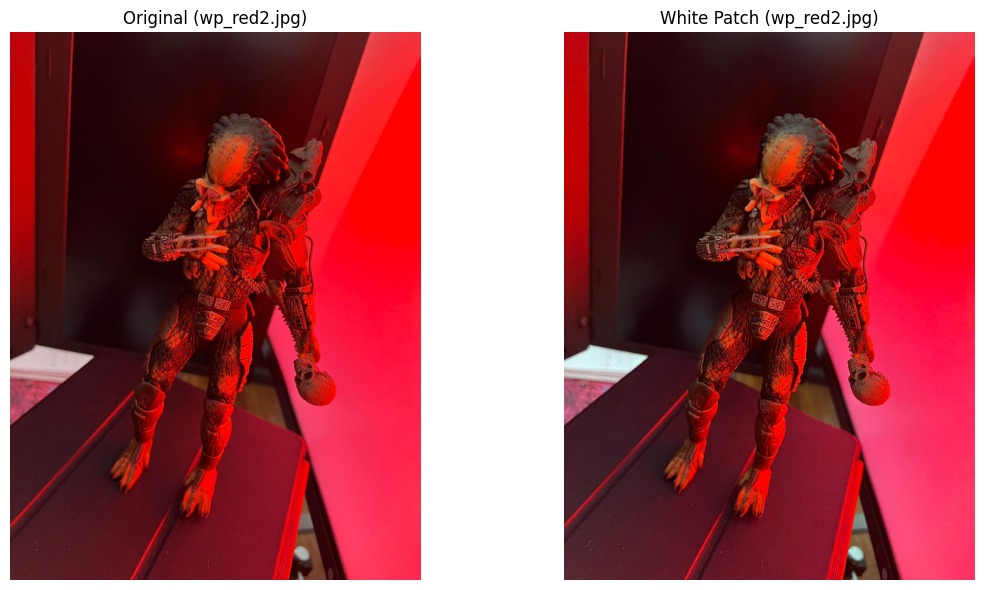


Procesamiento por lote completado.


In [ ]:
# Cargando las otras imagenes utilizando un for y corriendo todas juntas por el algoritmo
BASE_PATH = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\white_patch"

# 2. Definir los nombres de los archivos
file_names = [
    "wp_blue.jpg", 
    "wp_green.png", 
    "wp_green2.jpg", 
    "wp_red.png", 
    "wp_red2.jpg"
]

# Lista para almacenar los resultados (opcional, pero útil si quieres usarlos después)
processed_images = []

print(f"Iniciando procesamiento de {len(file_names)} imágenes...")

# 3. Iterar sobre la lista de archivos
for file_name in file_names:
    
    # Construir la ruta completa al archivo
    full_path = os.path.join(BASE_PATH, file_name)
    print(f"\nProcesando: {file_name}...")

    # Cargar la imagen
    img_original_rgb = cargar_y_mostrar_imagen(full_path)

    if img_original_rgb is not None:
        # Aplicar el algoritmo White Patch
        img_corregida_rgb = white_patch_rgb(img_original_rgb)

        # Guardar los resultados
        processed_images.append({
            'filename': file_name,
            'original': img_original_rgb,
            'corrected': img_corregida_rgb
        })

        # Mostrar la comparación inmediatamente
        mostrar_comparacion(
            img_original_rgb, 
            img_corregida_rgb, 
            titulo_original=f"Original ({file_name})", 
            titulo_corregida=f"White Patch ({file_name})"
        )
    else:
        print(f"🚫 Falla: No se pudo cargar la imagen {file_name}. Saltando.")

print("\nProcesamiento por lote completado.")

## Comentarios sobre las imágenes:

Podemos ver que en las primeras imagenes de las manos con los distintos colores, hay un buen desempeño del algoritmo. De hecho en las 3 versiones de imagenes con luces de distintos colores, los resultados al pasar por la función  **white_patch_rgb** son iguales. 

Para el caso de las imágenes del muñeco, en algunos casos el algoritmo logra mejorar aunque sea un poco el contraste de colores. Pueden verse cambios en la cabeza del muñeco. Pero para las imágenes wp_green2 y wp_red2, no se observan mejoras.

### Versión superadora en la función **white_patch_rgb**.

En vez de tomar el máximo de cada color, tomaremos un valor del percentil que iremos ajustando. Eso lo haremos con la funcion **percentile_white_patch_rgb**.




In [20]:


def percentile_white_patch_rgb(img_rgb, percentile=95):
    """
    Aplica el algoritmo Percentile White Patch para balancear los blancos,
    usando un percentil alto en lugar del valor máximo absoluto (100%).

    Args:
        img_rgb (numpy.ndarray): La imagen de entrada en formato RGB (0-255).
        percentile (int): El percentil de intensidad (0 a 100) a usar como
                          referencia del "blanco" (e.g., 95 o 99).

    Returns:
        numpy.ndarray: La imagen corregida en formato RGB (0-255).
    """
    if not 0 <= percentile <= 100:
        raise ValueError("El percentil debe estar entre 0 y 100.")
        
    # 1. Preparación: Convertir a punto flotante (0.0 a 1.0)
    img_float = img_rgb.astype(np.float32) / 255.0
    C_max = 1.0

    # 2. Identificar el valor de intensidad en el percentil dado para cada canal
    # R: canal 0, G: canal 1, B: canal 2
    
    # np.percentile requiere que la matriz sea plana para el cálculo
    R_percentile = np.percentile(img_float[:, :, 0], percentile)
    G_percentile = np.percentile(img_float[:, :, 1], percentile)
    B_percentile = np.percentile(img_float[:, :, 2], percentile)
    
    # Evitar división por cero o valores muy pequeños si el percentil cae en negro
    R_ref = max(R_percentile, 1e-6)
    G_ref = max(G_percentile, 1e-6)
    B_ref = max(B_percentile, 1e-6)
    
    print(f"Valores de referencia (Percentil {percentile}) (R, G, B): ({R_ref:.4f}, {G_ref:.4f}, {B_ref:.4f})")

    # 3. Calcular los factores de ganancia (K = C_max / C_ref)
    K_R = C_max / R_ref
    K_G = C_max / G_ref
    K_B = C_max / B_ref

    # 4. Aplicar los factores de ganancia a todos los píxeles
    img_corrected = np.zeros_like(img_float)
    
    img_corrected[:, :, 0] = img_float[:, :, 0] * K_R # R
    img_corrected[:, :, 1] = img_float[:, :, 1] * K_G # G
    img_corrected[:, :, 2] = img_float[:, :, 2] * K_B # B

    # 5. Asegurar que los valores no excedan el rango [0.0, 1.0] (clipping)
    img_corrected = np.clip(img_corrected, 0.0, 1.0)

    # 6. Finalización: Convertir de nuevo a formato de 8 bits (0-255)
    img_output = (img_corrected * 255).astype(np.uint8)

    return img_output


Procesando: wp_blue.jpg...
Valores de referencia (Percentil 90) (R, G, B): (0.1725, 0.1608, 0.9608)


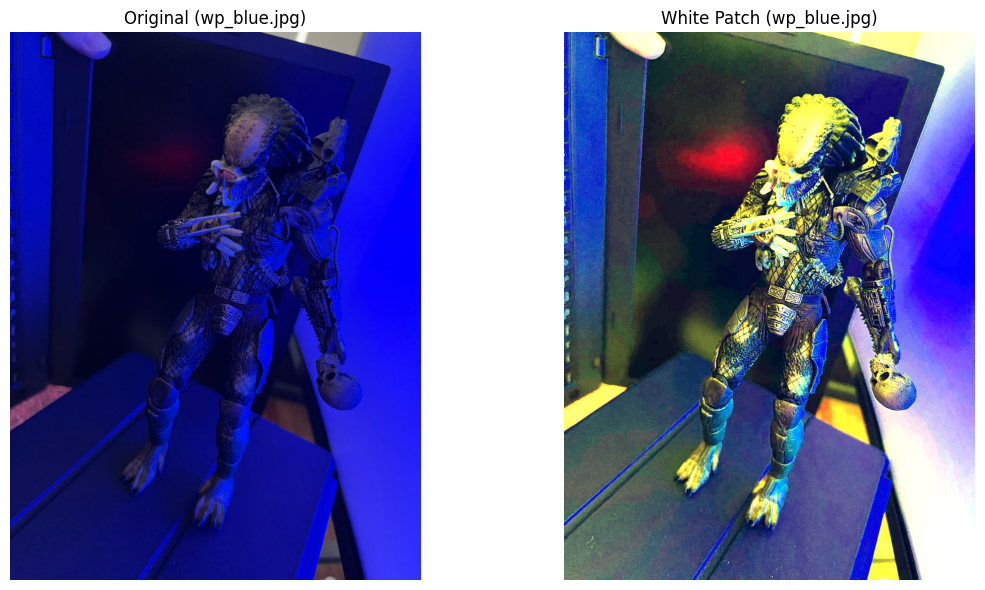


Procesando: wp_green.png...
Valores de referencia (Percentil 90) (R, G, B): (0.2510, 0.9137, 0.3137)


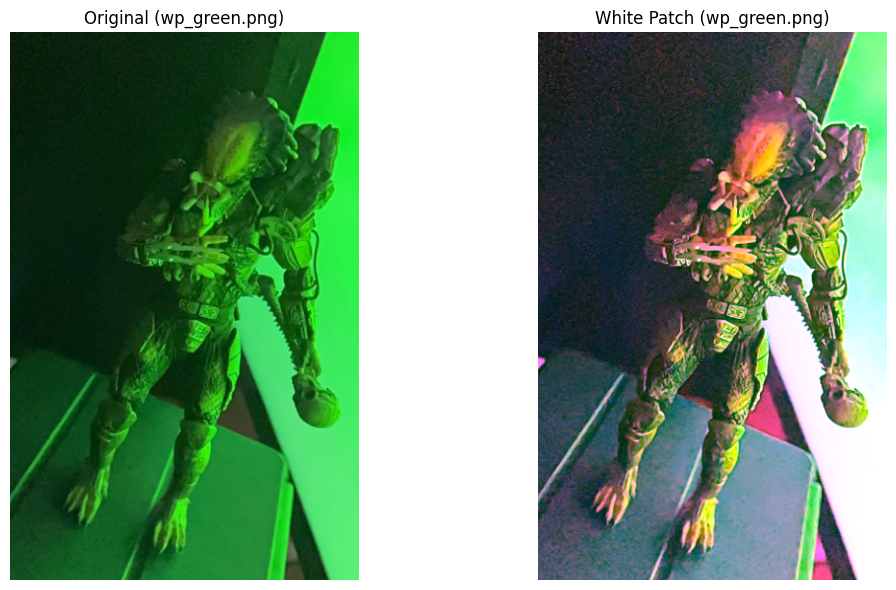


Procesando: wp_green2.jpg...
Valores de referencia (Percentil 90) (R, G, B): (0.0353, 0.9961, 0.0353)


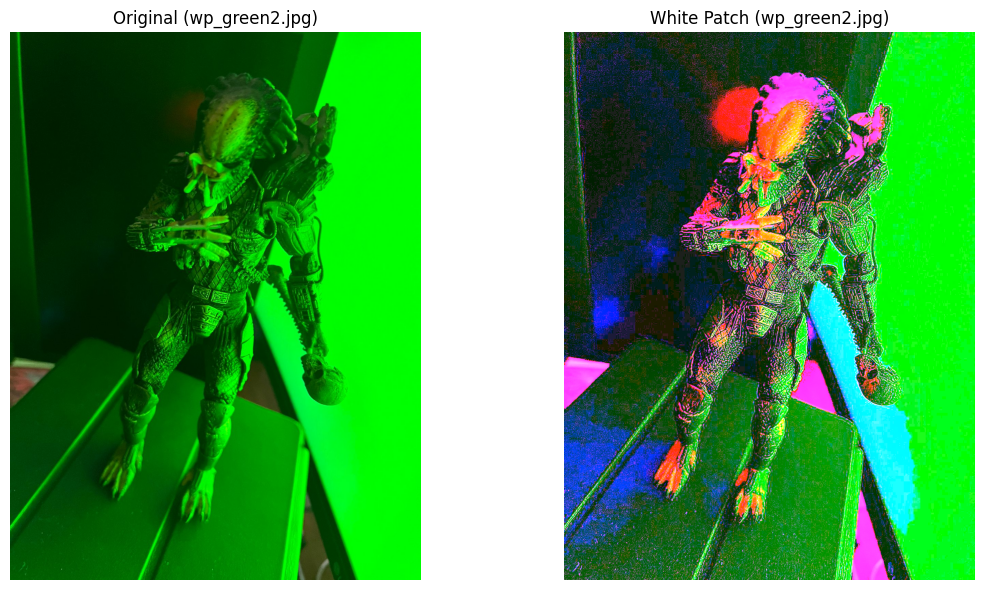


Procesando: wp_red.png...
Valores de referencia (Percentil 90) (R, G, B): (0.9922, 0.1922, 0.2549)


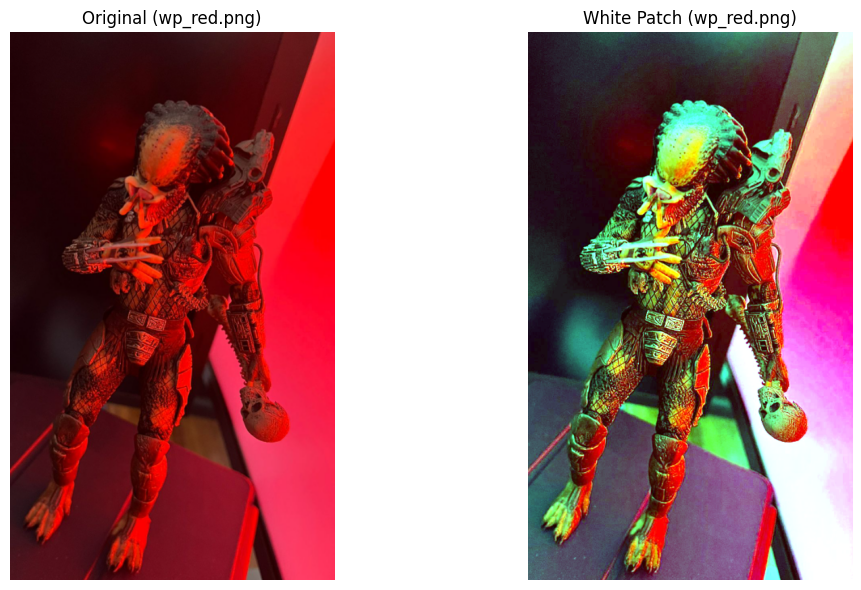


Procesando: wp_red2.jpg...
Valores de referencia (Percentil 90) (R, G, B): (0.9961, 0.1922, 0.3020)


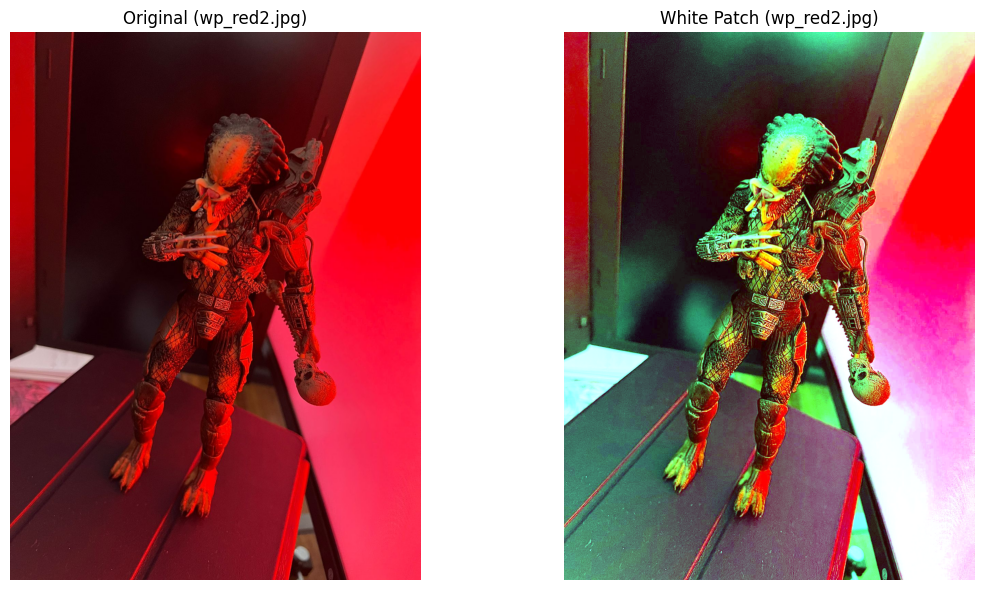


Procesamiento por lote completado.


In [ ]:
lis_percentil = [90, 92, 94, 96, 98]
for file_name in file_names:
    
    # Construir la ruta completa al archivo
    full_path = os.path.join(BASE_PATH, file_name)
    print(f"\nProcesando: {file_name}...")

    # Cargar la imagen
    img_original_rgb = cargar_y_mostrar_imagen(full_path)
    for percentil in lis_percentil:
        if img_original_rgb is not None:
            # Aplicar el algoritmo White Patch
            img_corregida_rgb = percentile_white_patch_rgb(img_original_rgb, percentil)

            # Guardar los resultados
            processed_images.append({
                'filename': file_name,
                'original': img_original_rgb,
                'corrected': img_corregida_rgb
            })

            # Mostrar la comparación inmediatamente
            mostrar_comparacion(
                img_original_rgb, 
                img_corregida_rgb, 
                titulo_original=f"Original ({file_name})", 
                titulo_corregida=f"White Patch ({file_name})"
            )
        else:
            print(f"🚫 Falla: No se pudo cargar la imagen {file_name}. Saltando.")

print("\nProcesamiento por lote completado.")


Procesando: wp_blue.jpg...
Valores de referencia (Percentil 90) (R, G, B): (0.1725, 0.1608, 0.9608)


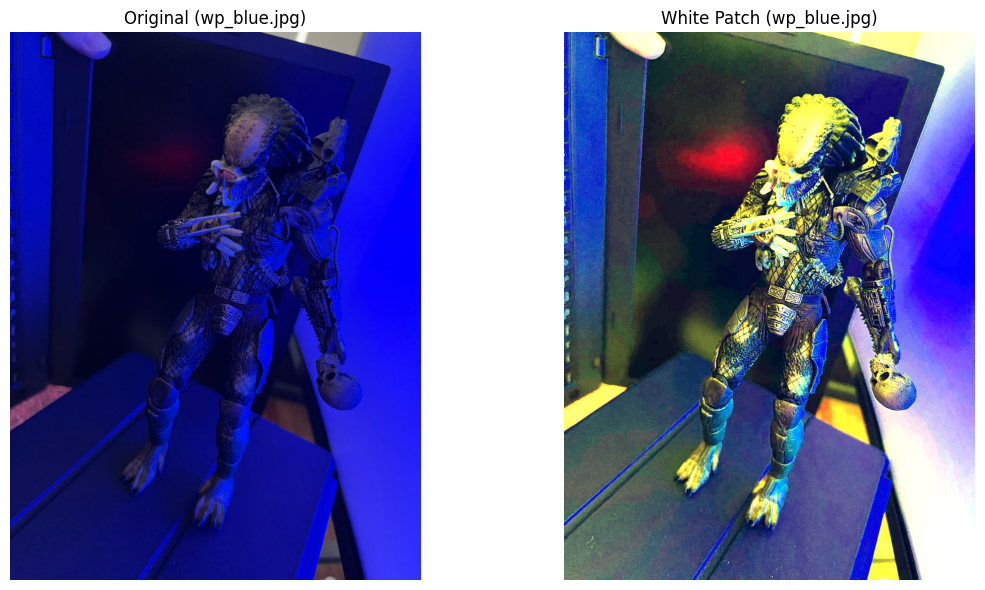

Valores de referencia (Percentil 92) (R, G, B): (0.1922, 0.1725, 0.9725)


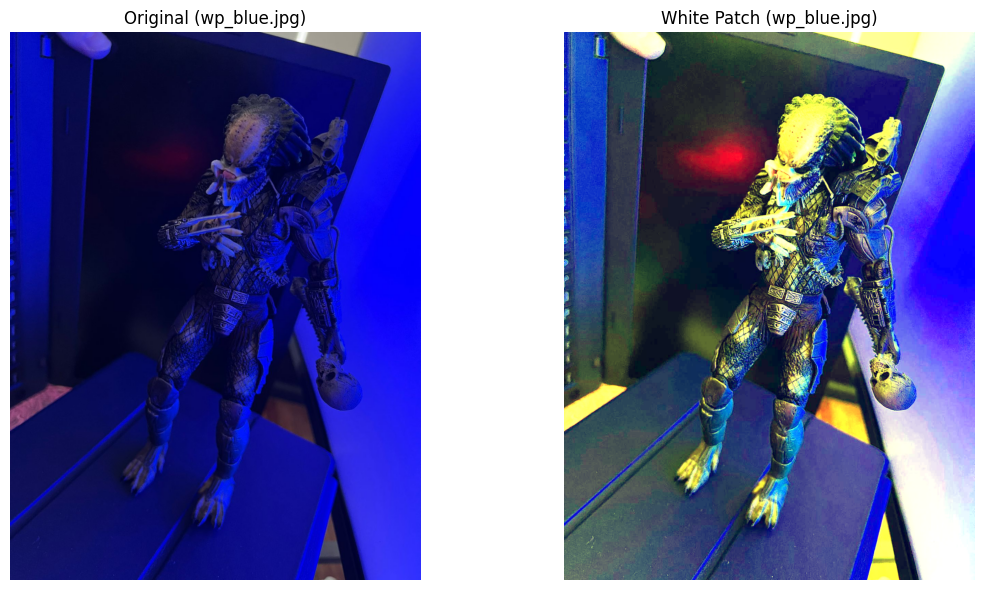

Valores de referencia (Percentil 94) (R, G, B): (0.2078, 0.1922, 0.9843)


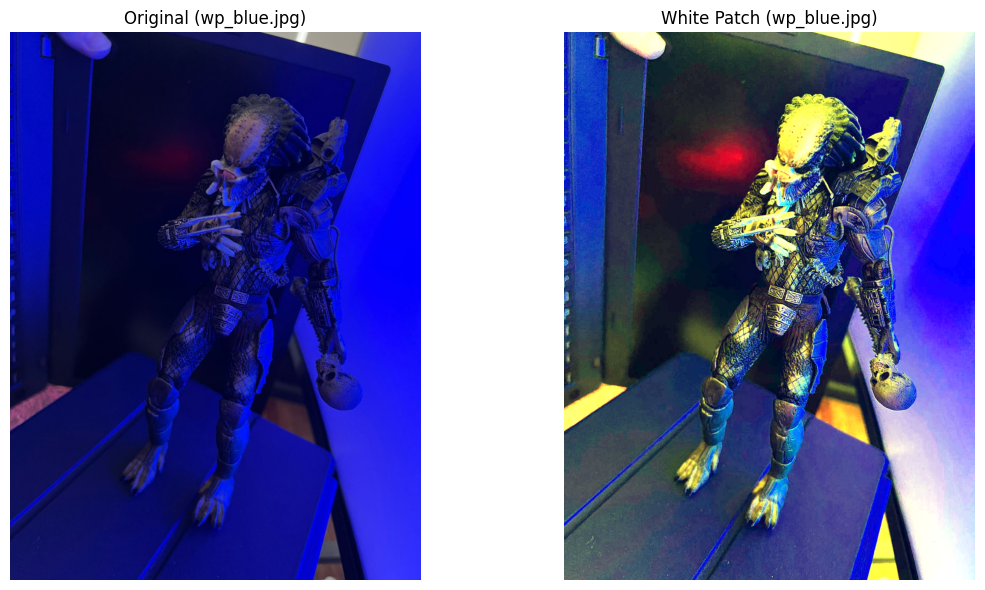

Valores de referencia (Percentil 96) (R, G, B): (0.2314, 0.2157, 0.9882)


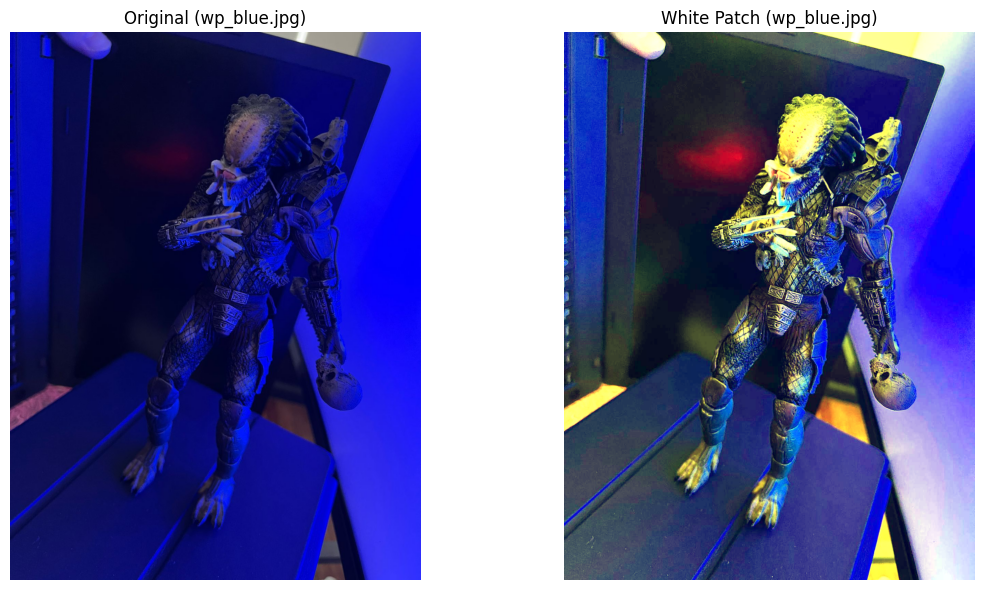

Valores de referencia (Percentil 98) (R, G, B): (0.3373, 0.2706, 0.9922)


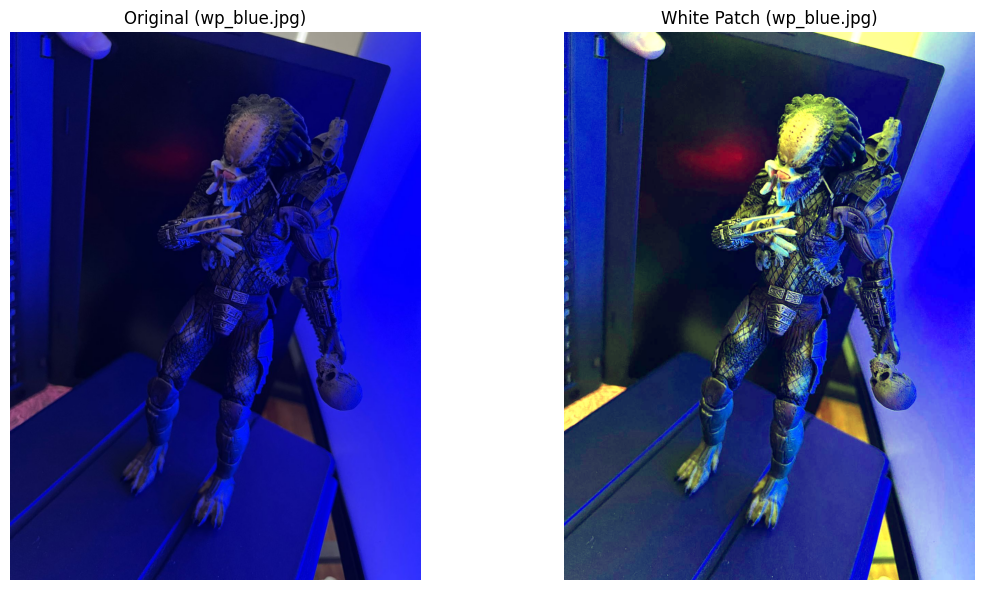

Valores de referencia (Percentil 100) (R, G, B): (1.0000, 1.0000, 1.0000)


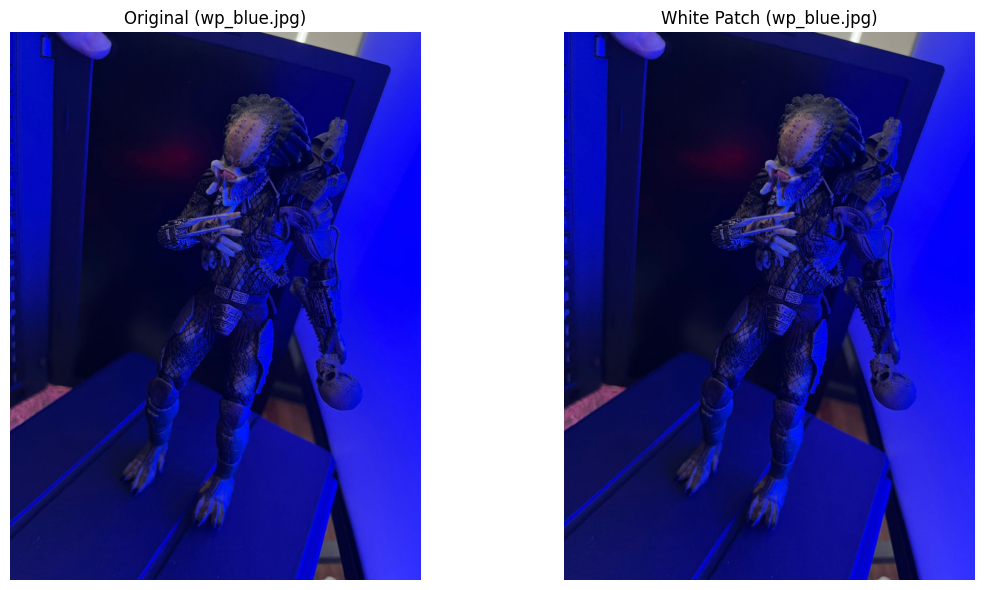


Procesando: wp_green.png...
Valores de referencia (Percentil 90) (R, G, B): (0.2510, 0.9137, 0.3137)


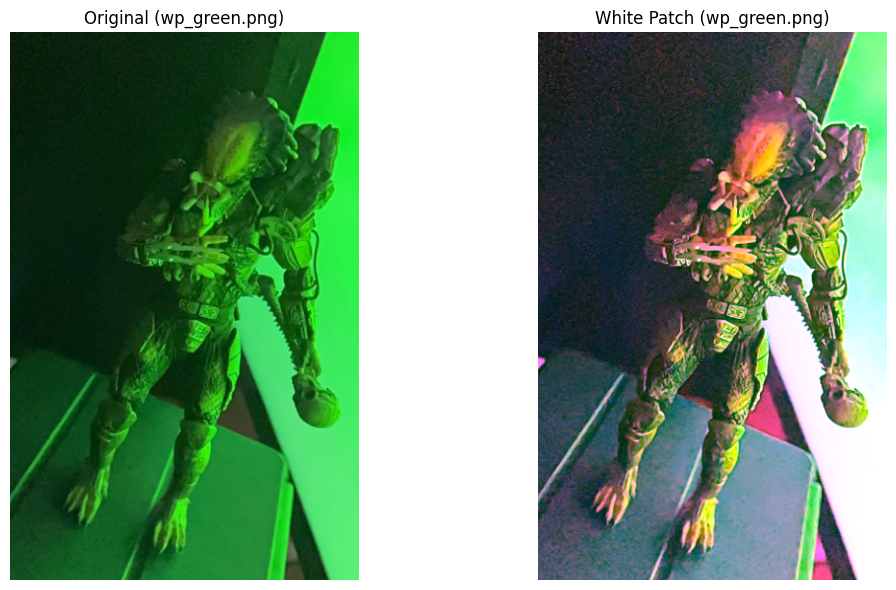

Valores de referencia (Percentil 92) (R, G, B): (0.2745, 0.9216, 0.3725)


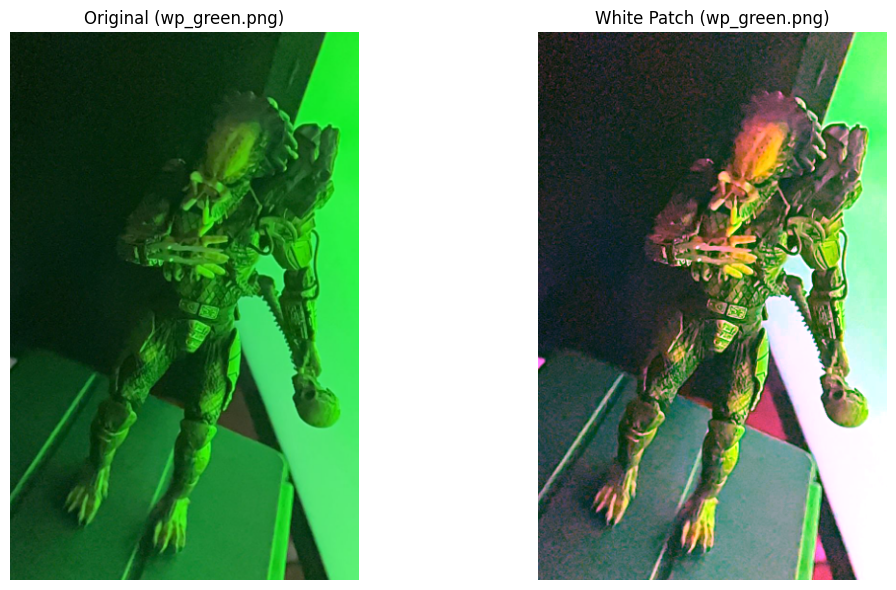

Valores de referencia (Percentil 94) (R, G, B): (0.2980, 0.9294, 0.4353)


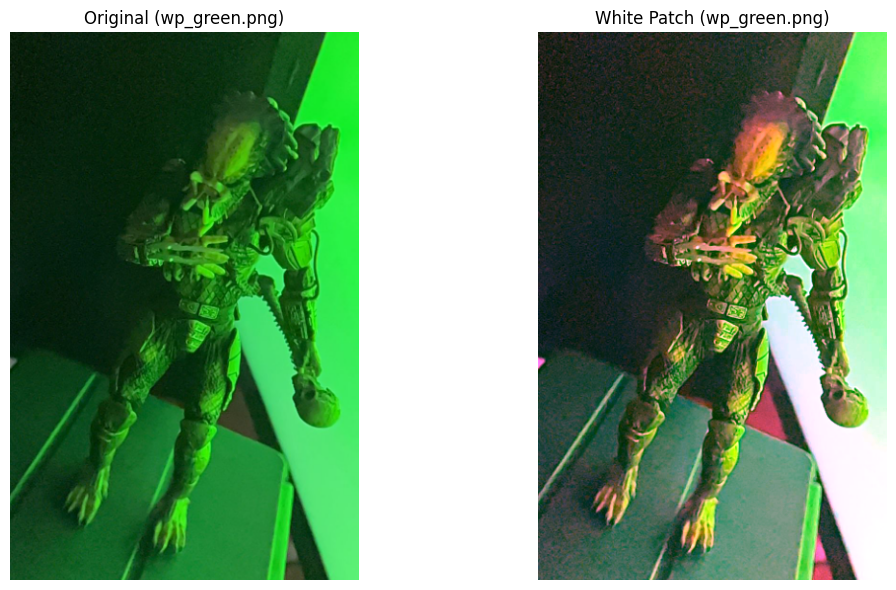

Valores de referencia (Percentil 96) (R, G, B): (0.3255, 0.9373, 0.4549)


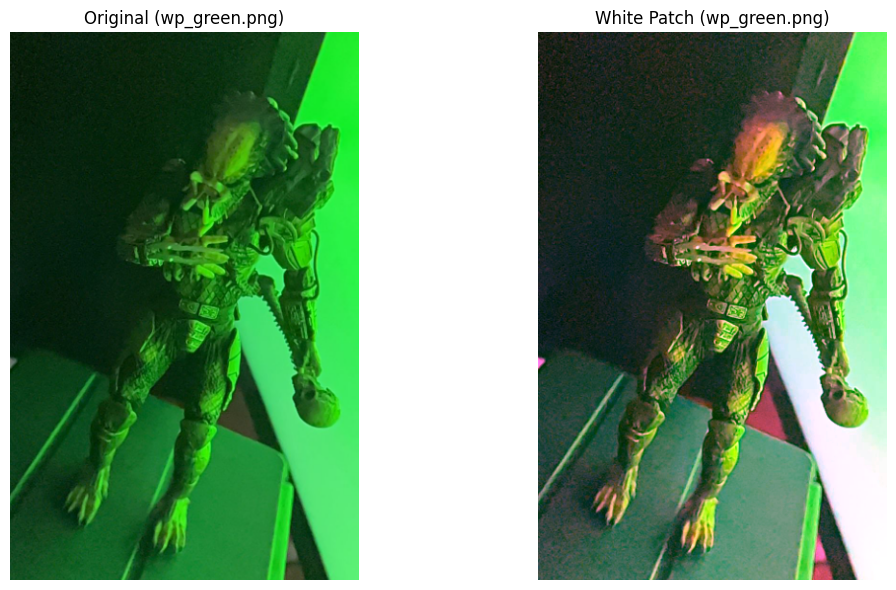

Valores de referencia (Percentil 98) (R, G, B): (0.3412, 0.9490, 0.4627)


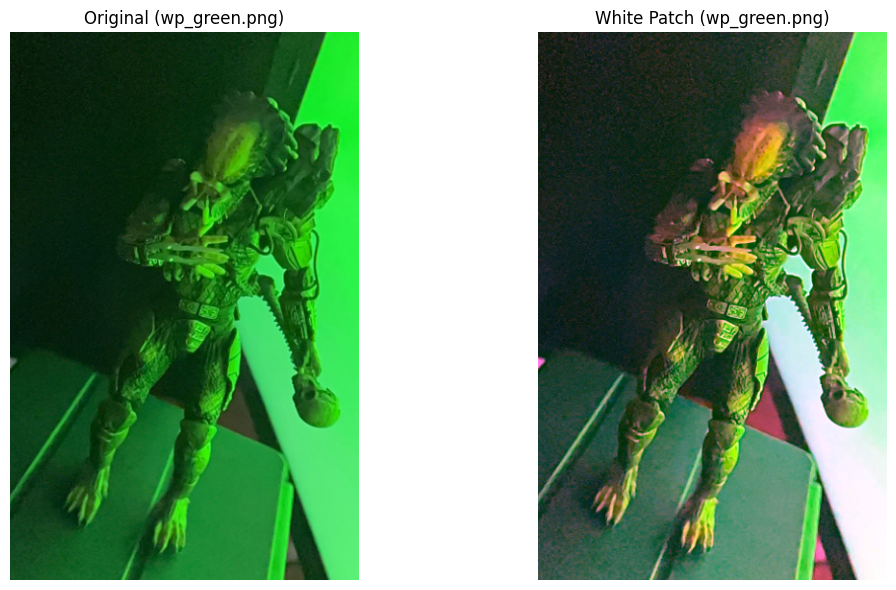

Valores de referencia (Percentil 100) (R, G, B): (0.4941, 0.9882, 0.6078)


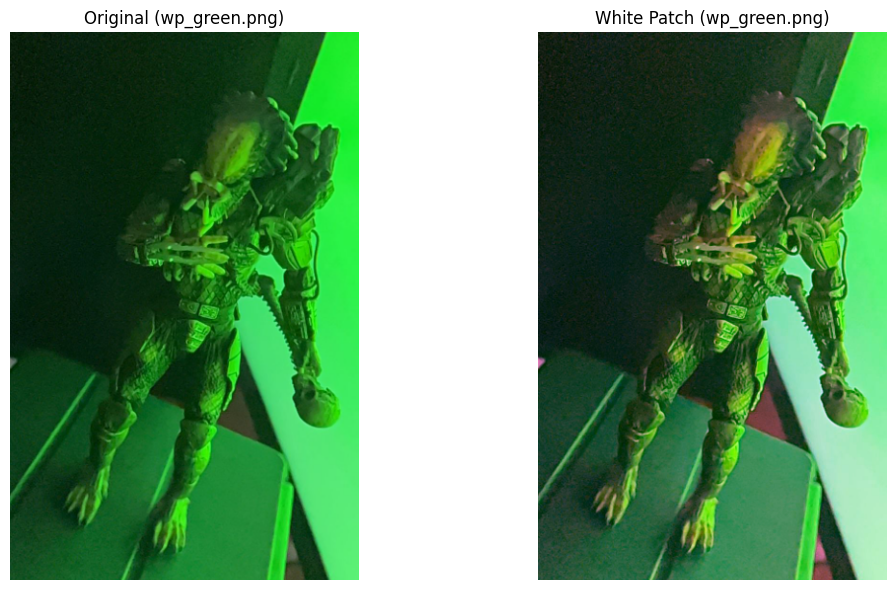


Procesando: wp_green2.jpg...
Valores de referencia (Percentil 90) (R, G, B): (0.0353, 0.9961, 0.0353)


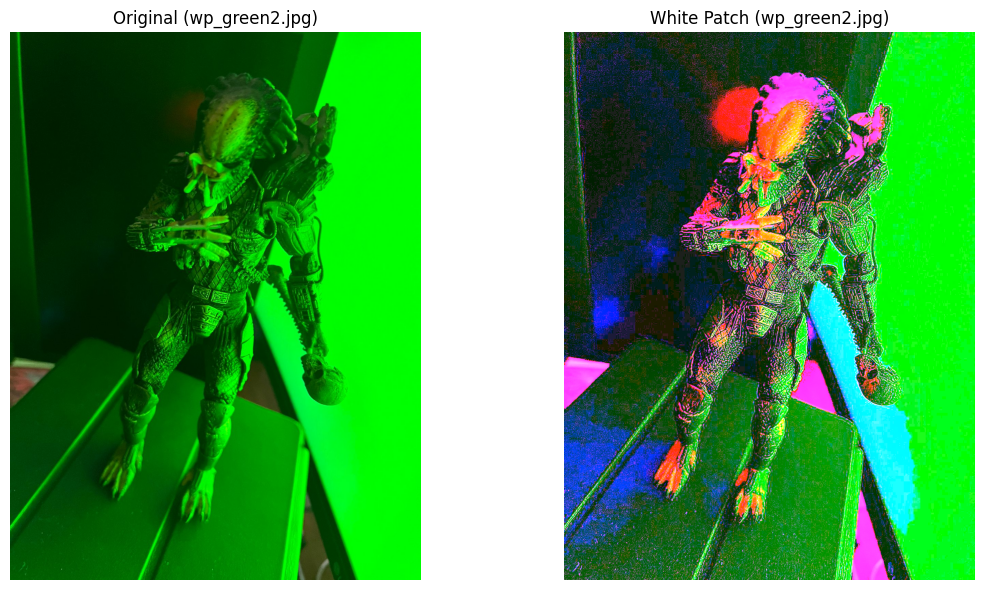

Valores de referencia (Percentil 92) (R, G, B): (0.0549, 0.9961, 0.0510)


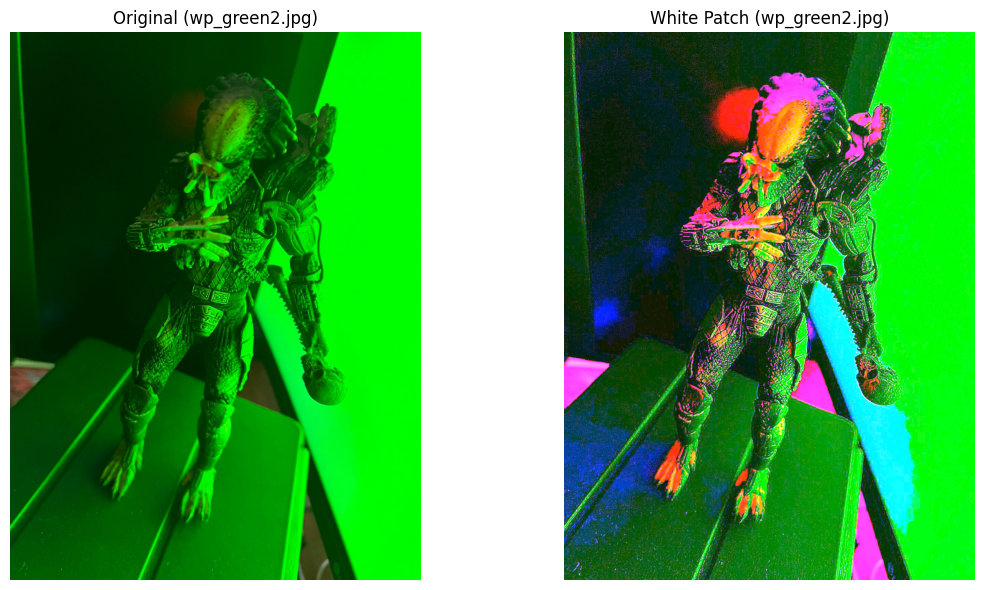

Valores de referencia (Percentil 94) (R, G, B): (0.0902, 0.9961, 0.0745)


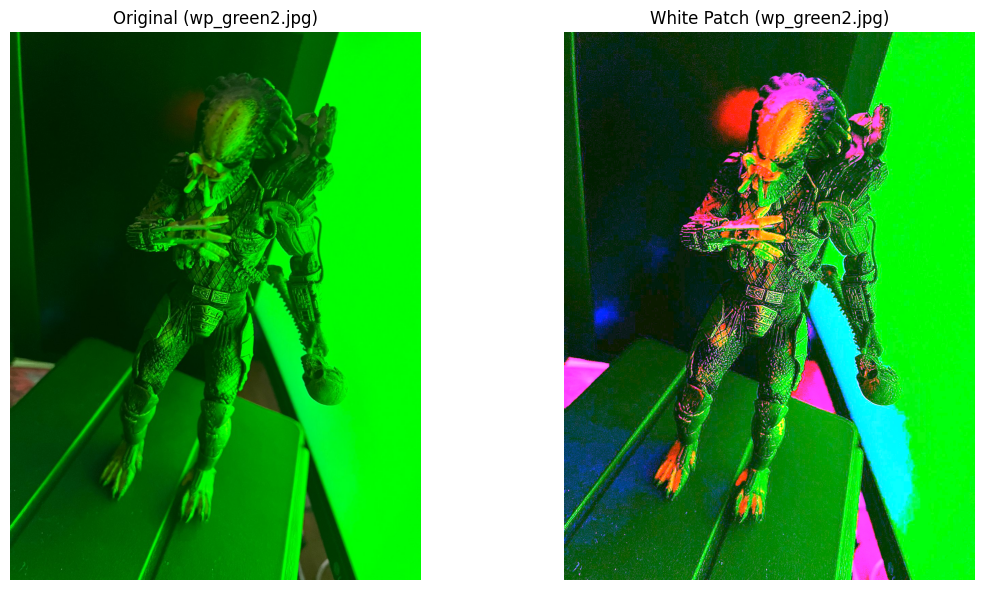

Valores de referencia (Percentil 96) (R, G, B): (0.1451, 1.0000, 0.1137)


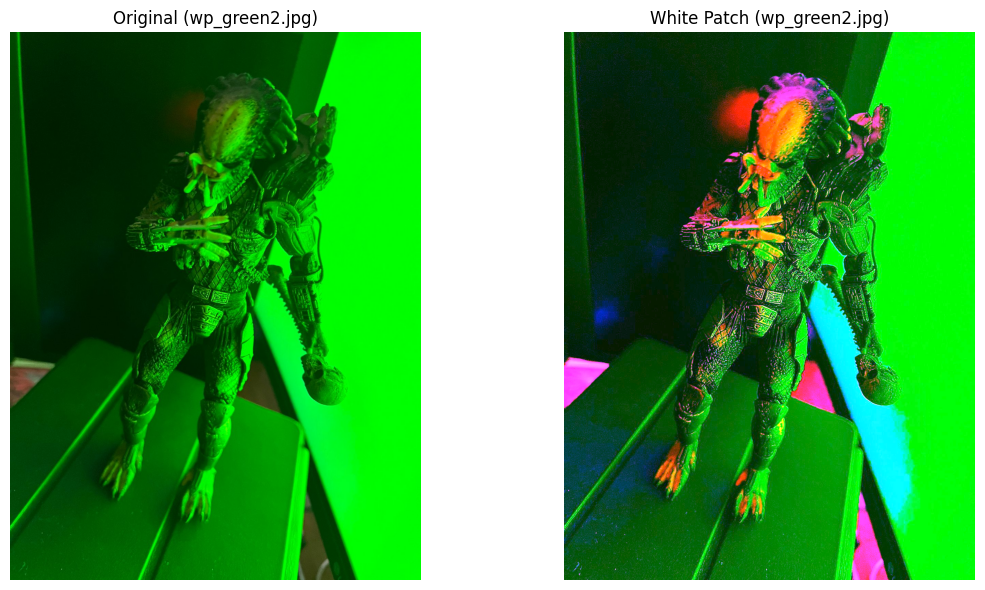

Valores de referencia (Percentil 98) (R, G, B): (0.2275, 1.0000, 0.1725)


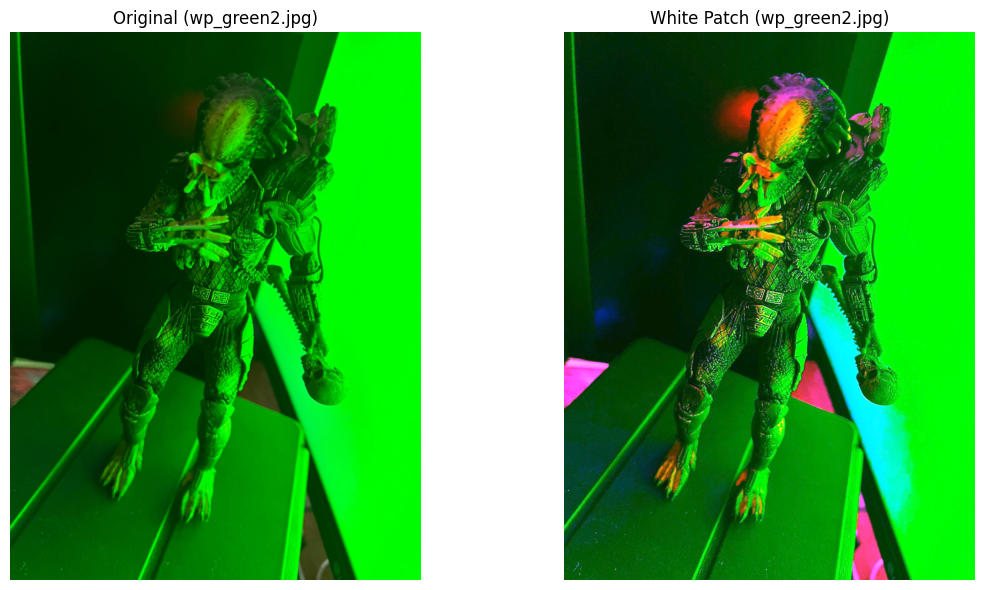

Valores de referencia (Percentil 100) (R, G, B): (0.6667, 1.0000, 0.6745)


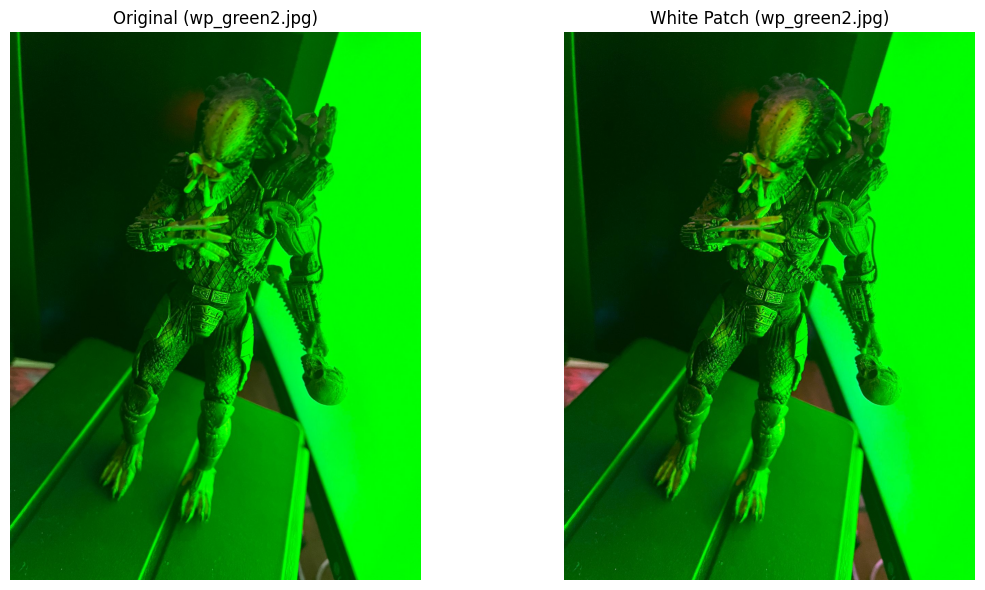


Procesando: wp_red.png...
Valores de referencia (Percentil 90) (R, G, B): (0.9922, 0.1922, 0.2549)


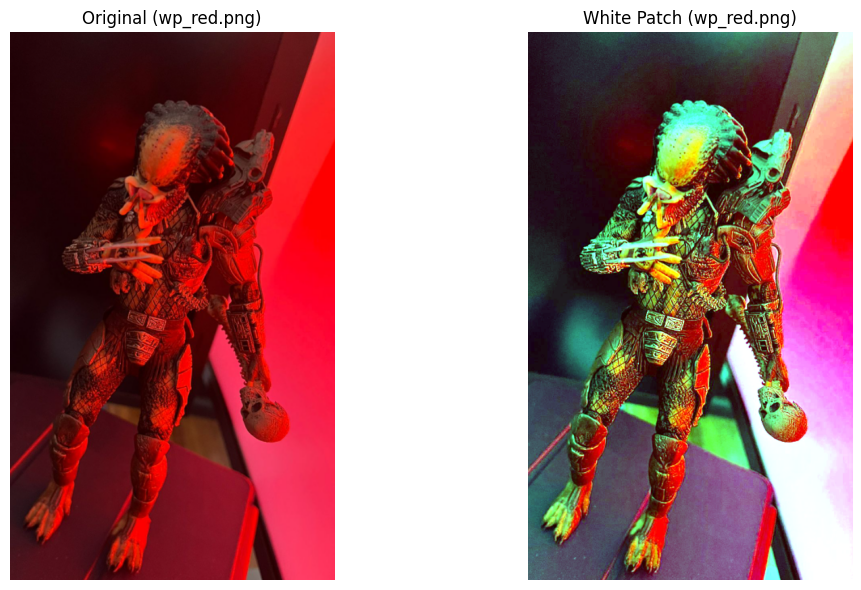

Valores de referencia (Percentil 92) (R, G, B): (0.9961, 0.2039, 0.2980)


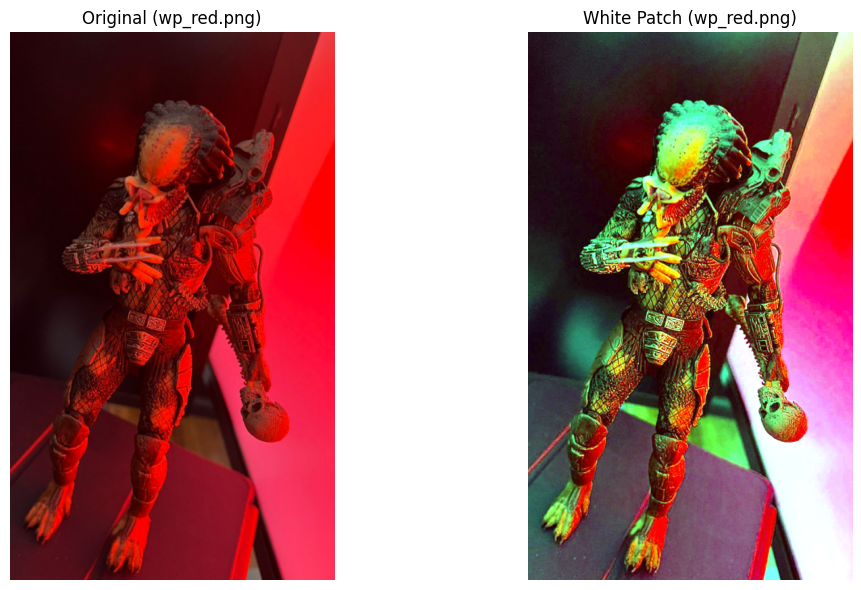

Valores de referencia (Percentil 94) (R, G, B): (1.0000, 0.2196, 0.3373)


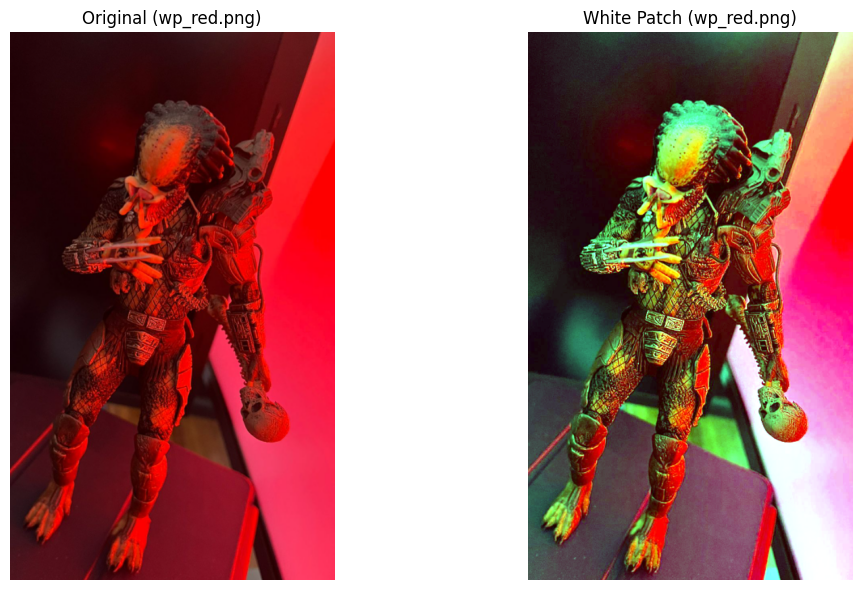

Valores de referencia (Percentil 96) (R, G, B): (1.0000, 0.2314, 0.3647)


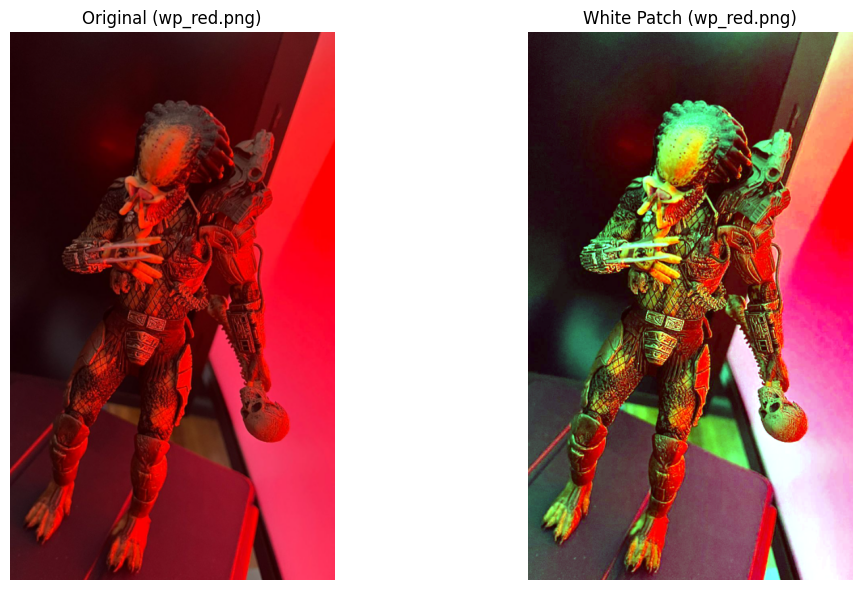

Valores de referencia (Percentil 98) (R, G, B): (1.0000, 0.2588, 0.3882)


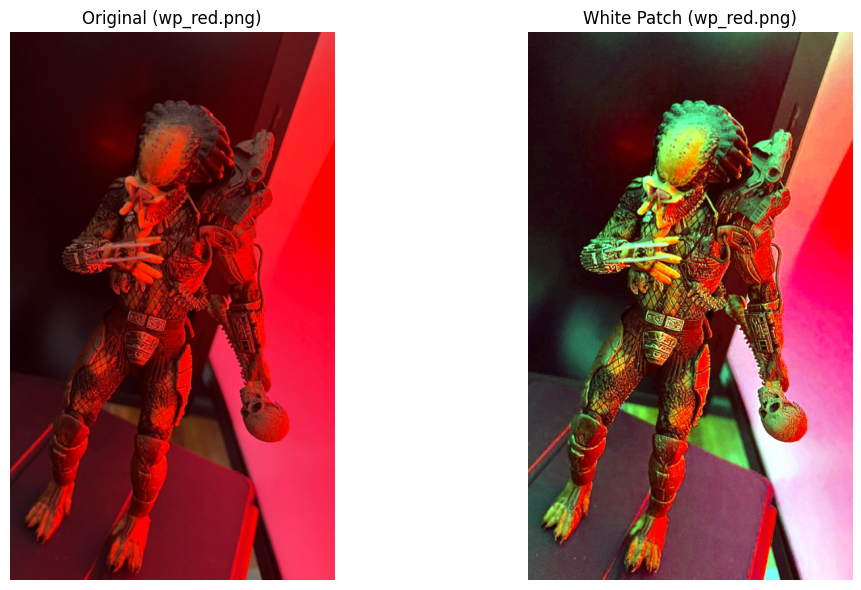

Valores de referencia (Percentil 100) (R, G, B): (1.0000, 0.5255, 0.4784)


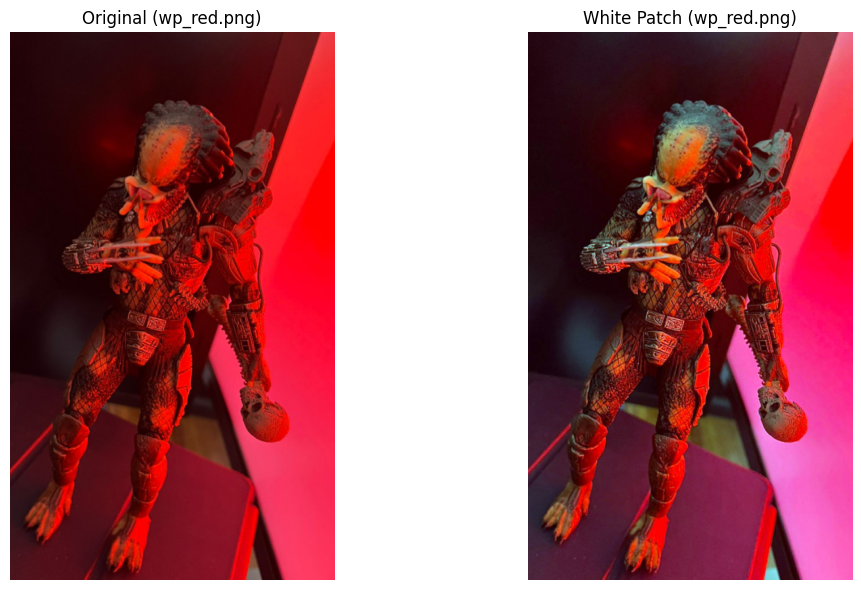


Procesando: wp_red2.jpg...
Valores de referencia (Percentil 90) (R, G, B): (0.9961, 0.1922, 0.3020)


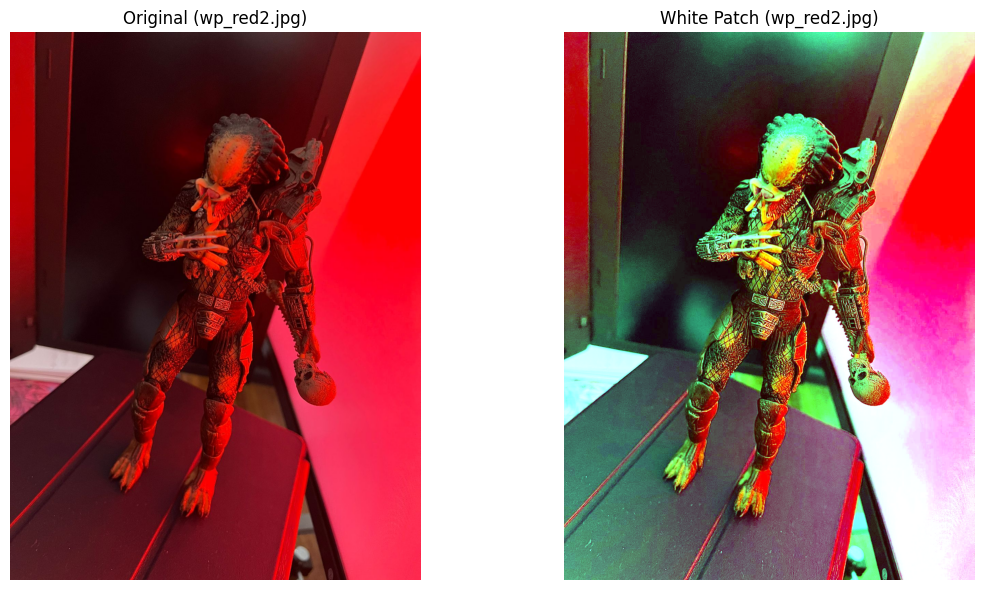

Valores de referencia (Percentil 92) (R, G, B): (1.0000, 0.2078, 0.3216)


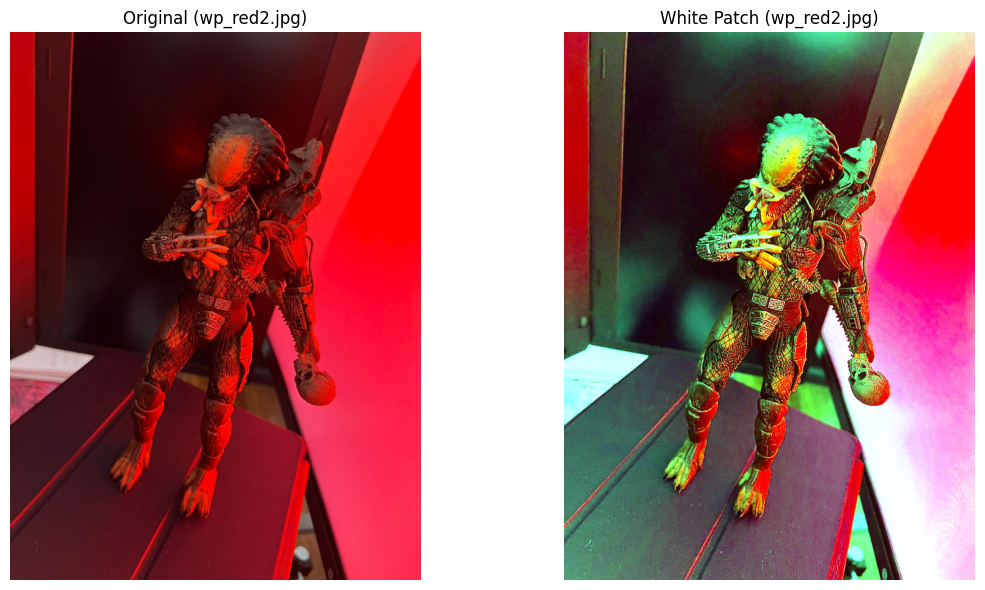

Valores de referencia (Percentil 94) (R, G, B): (1.0000, 0.2235, 0.3412)


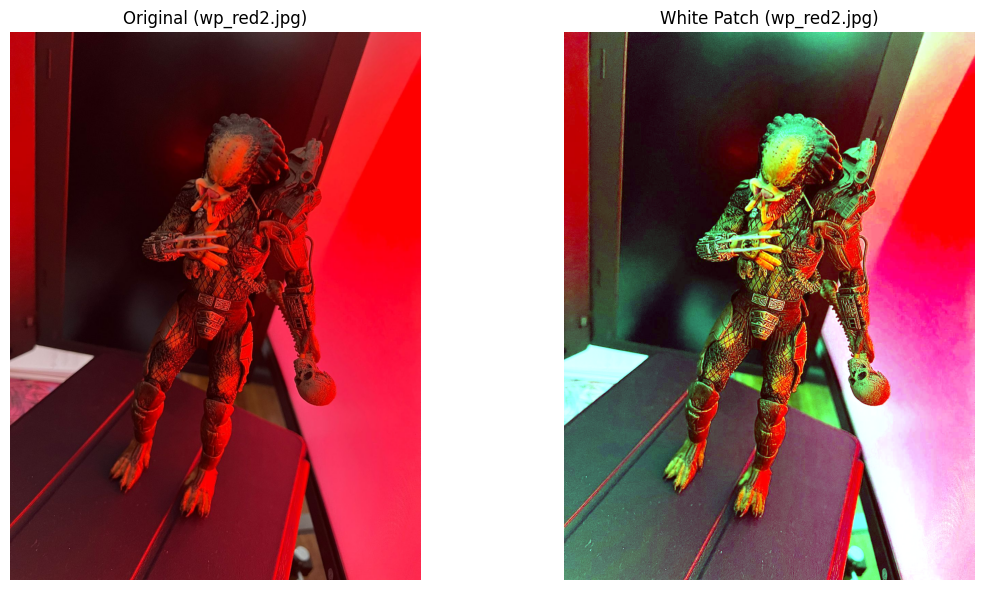

Valores de referencia (Percentil 96) (R, G, B): (1.0000, 0.2431, 0.3686)


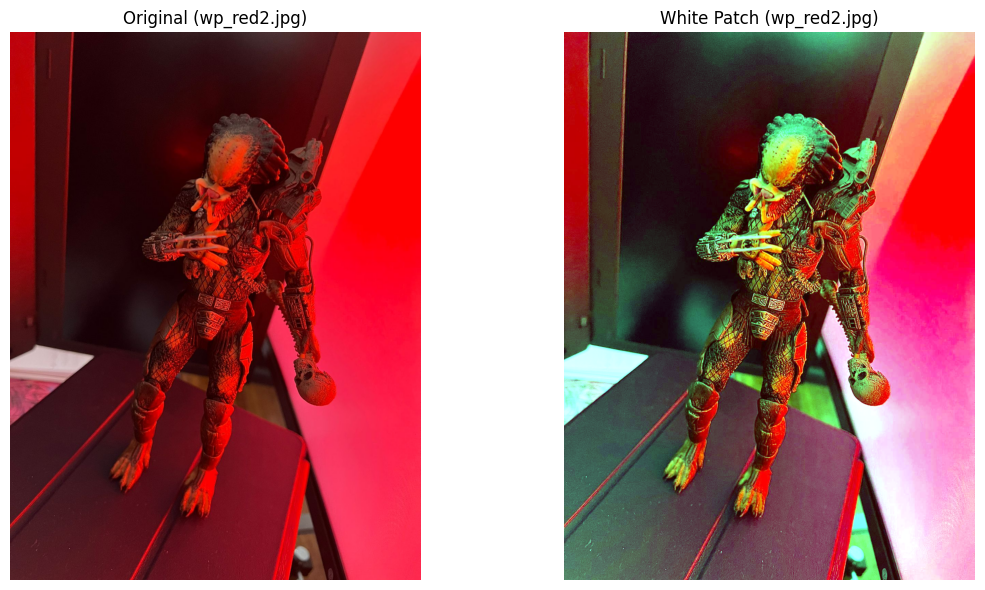

Valores de referencia (Percentil 98) (R, G, B): (1.0000, 0.2980, 0.3961)


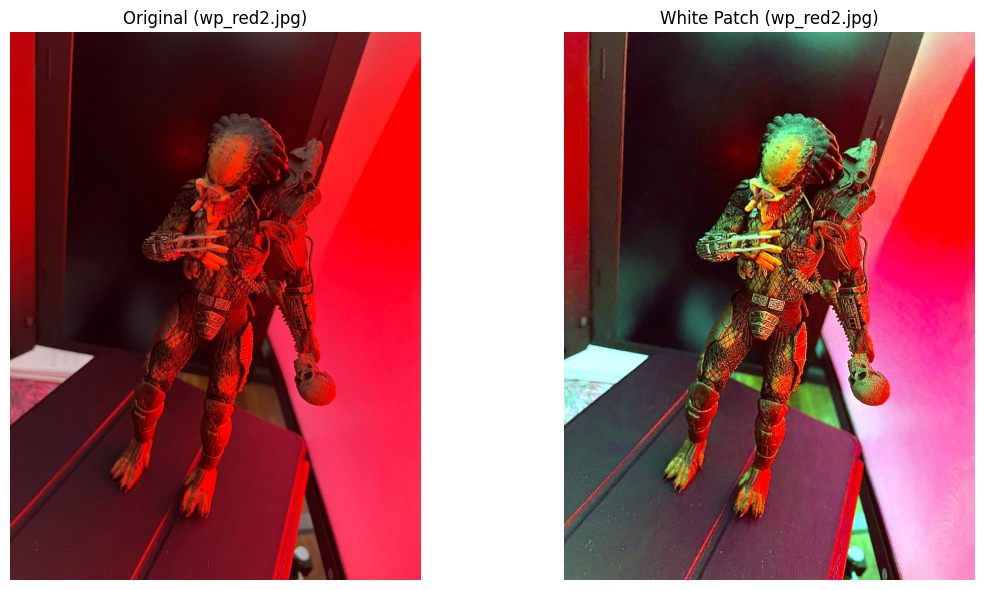

Valores de referencia (Percentil 100) (R, G, B): (1.0000, 0.7882, 0.7961)


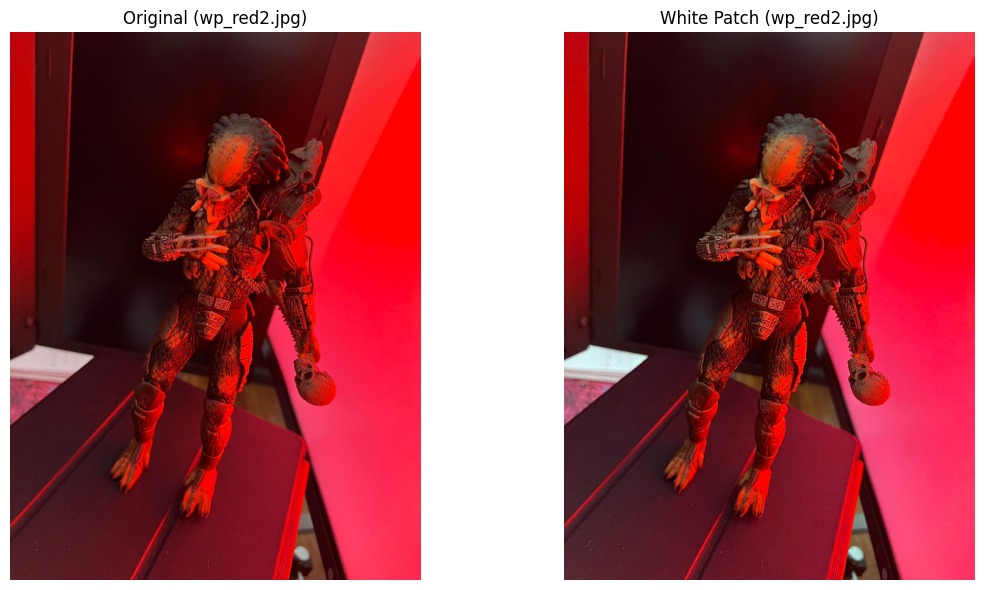


Procesamiento por lote completado.


In [26]:
lis_percentil = [90, 92, 94, 96, 98, 100]
for file_name in file_names:
    
    # Construir la ruta completa al archivo
    full_path = os.path.join(BASE_PATH, file_name)
    print(f"\nProcesando: {file_name}...")

    # Cargar la imagen
    img_original_rgb = cargar_y_mostrar_imagen(full_path)
    for percentil in lis_percentil:
        if img_original_rgb is not None:
            # Aplicar el algoritmo White Patch
            img_corregida_rgb = percentile_white_patch_rgb(img_original_rgb, percentil)

            # Guardar los resultados
            processed_images.append({
                'filename': file_name,
                'original': img_original_rgb,
                'corrected': img_corregida_rgb
            })

            # Mostrar la comparación inmediatamente
            mostrar_comparacion(
                img_original_rgb, 
                img_corregida_rgb, 
                titulo_original=f"Original ({file_name})", 
                titulo_corregida=f"White Patch ({file_name})"
            )
        else:
            print(f"🚫 Falla: No se pudo cargar la imagen {file_name}. Saltando.")

print("\nProcesamiento por lote completado.")

## Conclusiones:


¿Qué valor elegir para el percentil?

No somos expertos en imágenes ni en fotografía, pero pareciera ser que la mejor eleccion del percentil depende de cada imagen en particular. Sin embargo en lineas generales, podriamos decir que si elegimos un valor de percentil bajo (90 por ejemplo) llevaria a saturacion de colores y pérdida de información. Por el otro lado, si elegimos un valor alto, también hay saturacon de colores porque no se logra generar contraste.

# Parte 2

### Histogramas de colores en distintas imagénes


[[  2   3   4 ...  13  13  14]
 [ 14  14  14 ...  20  20  20]
 [ 20  20  20 ...  22  22  22]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]


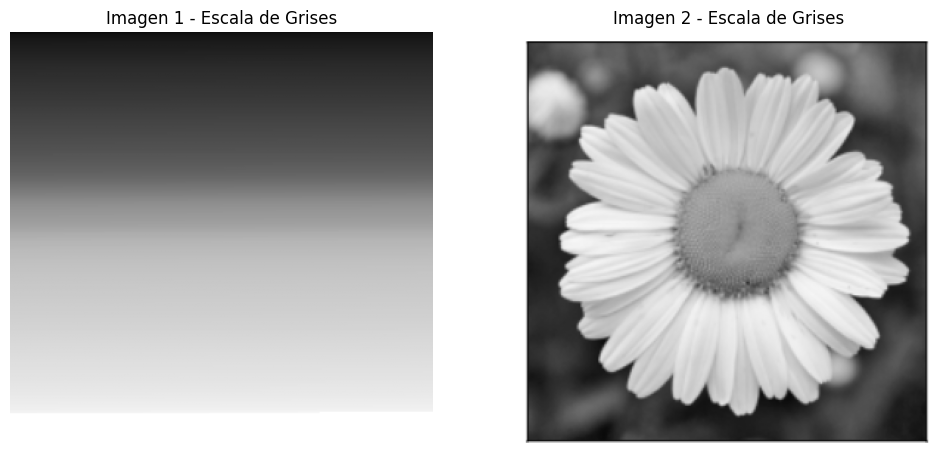

In [18]:
nombre_img1 = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\img1_tp.png"
nombre_img2 = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\img2_tp.png"

# Leer las imágenes directamente en escala de grises
# El segundo argumento, cv.IMREAD_GRAYSCALE (o 0), se encarga de esto.
img1_gris = cv.imread(nombre_img1, cv.IMREAD_GRAYSCALE)
img2_gris = cv.imread(nombre_img2, cv.IMREAD_GRAYSCALE)


# Dimensión de la imagen

print(img1_gris)


# Verificar que las imágenes se cargaron
if img1_gris is not None and img2_gris is not None:
    # Crea una figura y dos subplots (uno al lado del otro) para mostrar las imágenes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Muestra la primera imagen en el primer subplot
    axes[0].imshow(img1_gris, cmap='gray')
    axes[0].set_title('Imagen 1 - Escala de Grises')
    axes[0].axis('off') # Oculta los ejes para que se vea mejor

    # Muestra la segunda imagen en el segundo subplot
    axes[1].imshow(img2_gris, cmap='gray')
    axes[1].set_title('Imagen 2 - Escala de Grises')
    axes[1].axis('off')

    # Muestra la figura con ambas imágenes
    plt.show()
else:
    print("Error al cargar una o ambas imágenes. No se puede mostrar.")

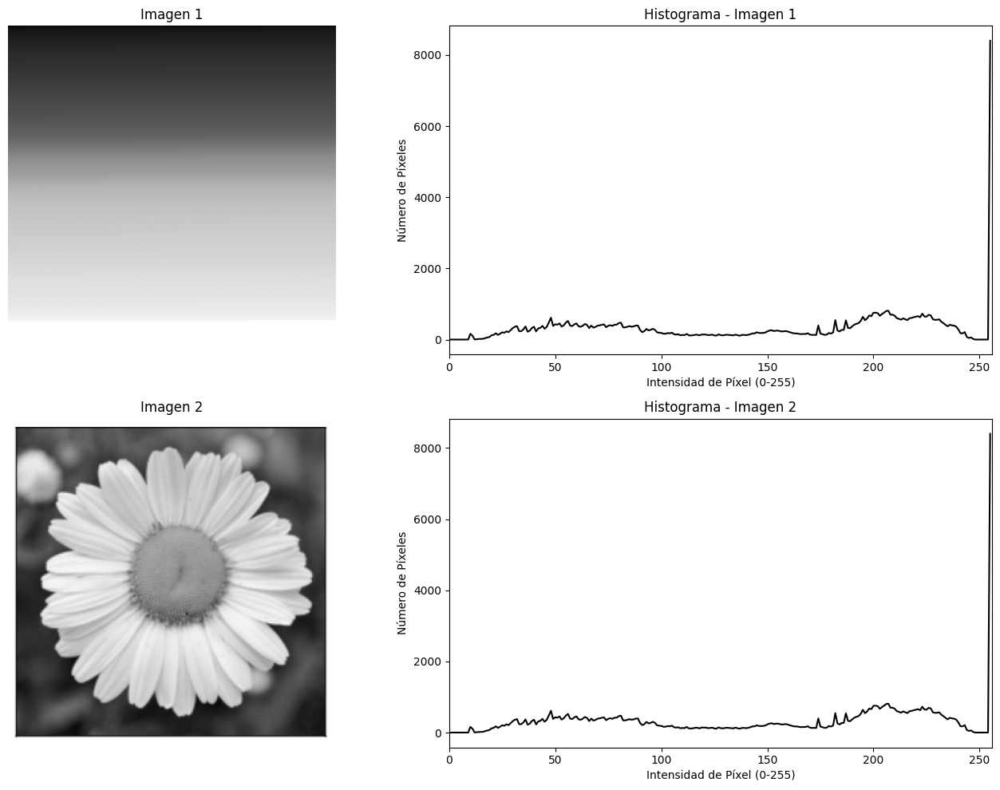

In [2]:
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np

# 1. Cargar las imágenes en escala de grises (código que ya tenías)
nombre_img1 = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\img1_tp.png"
nombre_img2 = r"C:\Users\nahue\Documents\Ceia\Vision_por_computador\vision_computadora_I\Material_TPs\TP1\img2_tp.png"

img1_gris = cv.imread(nombre_img1, cv.IMREAD_GRAYSCALE)
img2_gris = cv.imread(nombre_img2, cv.IMREAD_GRAYSCALE)

# Verificar si las imágenes se cargaron correctamente
if img1_gris is None or img2_gris is None:
    print("Error: No se pudo cargar una o ambas imágenes. Verifica las rutas.")
else:
    # 2. Calcular los histogramas usando cv.calcHist
    # Parámetros:
    # images: La imagen fuente, entre corchetes [].
    # channels: El índice del canal. Para escala de grises, es [0].
    # mask: Máscara para calcular el histograma solo en una región (None para toda la imagen).
    # histSize: Número de bins. Usamos [256].
    # ranges: El rango de intensidades. Usamos [0, 256].
    hist1 = cv.calcHist([img1_gris], [0], None, [256], [0, 256])
    hist2 = cv.calcHist([img2_gris], [0], None, [256], [0, 256])

    # 3. Graficar las imágenes y sus histogramas para compararlos
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))

    # --- Imagen 1 y su histograma ---
    axes[0, 0].imshow(img1_gris, cmap='gray')
    axes[0, 0].set_title('Imagen 1')
    axes[0, 0].axis('off')

    axes[0, 1].plot(hist1, color='black')
    axes[0, 1].set_title('Histograma - Imagen 1')
    axes[0, 1].set_xlabel('Intensidad de Píxel (0-255)')
    axes[0, 1].set_ylabel('Número de Píxeles')
    axes[0, 1].set_xlim([0, 256]) # Asegurar que el eje X vaya de 0 a 256

    # --- Imagen 2 y su histograma ---
    axes[1, 0].imshow(img2_gris, cmap='gray')
    axes[1, 0].set_title('Imagen 2')
    axes[1, 0].axis('off')

    axes[1, 1].plot(hist2, color='black')
    axes[1, 1].set_title('Histograma - Imagen 2')
    axes[1, 1].set_xlabel('Intensidad de Píxel (0-255)')
    axes[1, 1].set_ylabel('Número de Píxeles')
    axes[1, 1].set_xlim([0, 256])

    plt.tight_layout()
    plt.show()

Pareciera ser que ambos histogramas son iguales. Con los mismos valores. Para comprobar esto, hicimos la diferencia punto a punto del histograma de la imagen 1 con la imagen 2.

La Suma de la Diferencia Absoluta entre los histogramas es: 0.0
Conclusión: Los histogramas son numéricamente idénticos.


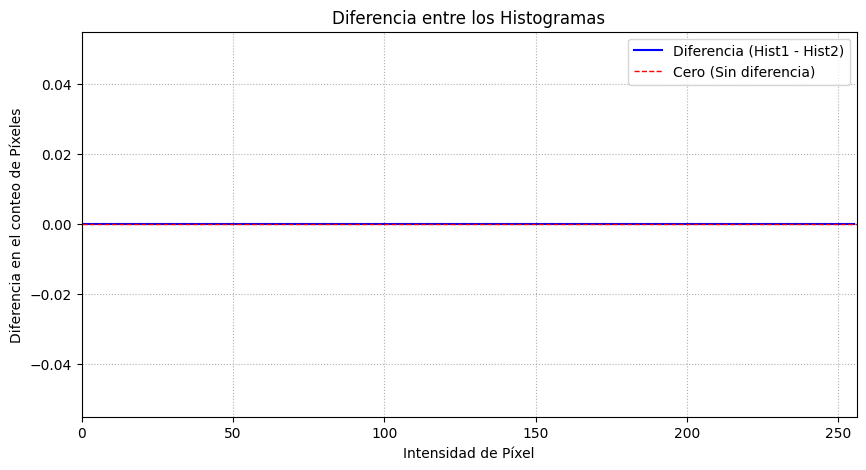


Usando cv2.compareHist:
El coeficiente de correlación entre los dos histogramas es: 1.0000
Conclusión: Coincidencia perfecta.


In [ ]:

# 1. Calcular la diferencia absoluta entre los dos histogramas.
# Usamos .flatten() para convertir los histogramas de shape (256, 1) a (256,) 
# lo que facilita algunas operaciones y el ploteo.
diferencia_hists = hist1.flatten() - hist2.flatten()

# 2. Calcular una métrica única para la diferencia total.
# La Suma de las Diferencias Absolutas (SAD) es una métrica simple y efectiva.
# Si es 0, los histogramas son idénticos.
suma_diferencia_absoluta = np.sum(np.abs(diferencia_hists))

print(f"La Suma de la Diferencia Absoluta entre los histogramas es: {suma_diferencia_absoluta}")

if suma_diferencia_absoluta == 0:
    print("Conclusión: Los histogramas son numéricamente idénticos.")
else:
    print("Conclusión: Los histogramas son diferentes.")

# 3. Graficar la diferencia para visualizarla.
# Si son idénticos, este gráfico debería ser una línea recta en y=0.
plt.figure(figsize=(10, 5))
plt.plot(diferencia_hists, color='blue', label='Diferencia (Hist1 - Hist2)')
# Añadimos una línea en cero como referencia visual clara
plt.axhline(0, color='red', linestyle='--', linewidth=1, label='Cero (Sin diferencia)')
plt.title('Diferencia entre los Histogramas')
plt.xlabel('Intensidad de Píxel')
plt.ylabel('Diferencia en el conteo de Píxeles')
plt.xlim([0, 256])
plt.legend()
plt.grid(True, linestyle=':')
plt.show()


# --- Alternativa: Usar la función de comparación de OpenCV ---
# OpenCV tiene una función específica para comparar histogramas con diferentes métricas.
# La correlación es una de las más intuitivas. 1.0 significa una coincidencia perfecta.
correlacion = cv.compareHist(hist1, hist2, cv.HISTCMP_CORREL)
print(f"\nUsando cv.compareHist:")
print(f"El coeficiente de correlación entre los dos histogramas es: {correlacion:.4f}")
if correlacion == 1.0:
    print("Conclusión: Coincidencia perfecta.")

## Conclusiones:

Los histogramas son 100 % identicos. 

Ante la pregunta de si pudiera utilizarse un método como este de reconocimiento de imágenes a travez de su histograma, la respuesta al ver estos resultados es que no es conveniente.

Sin embargo la verdad es que si bien no es un método 100 % robusto, podria aplicarse en ciertos casos en donde uno siempre tiene el mismo fondo de imagen y solo cambia el objeto que esta intentando distinguir, podria aplicarse este algoritmo.